Goal: write a function that takes in:

1. Earth's initial position (default = 0)
2. Object's initial position (default = 0)
3. estimated semimajor axis of object (a)
4. estimated eccentricity of object's orbit (e)
5. Error of a and e

Then it creates movies of the evolution of 5 orbits:

1. base a and e
2. base a + 1 stdev, base e
3. base a - 1 stdev, base e
4. base a, base e + 1 stdev
5. base a, base e - 1 stdev

/var/folders/ry/qny1f95136l2lpppg_d78n6c0000gq/T/ipykernel_41894/1139216461.py:66: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  earth_point.set_data(earth_positions[i, 0], earth_positions[i, 1])
/var/folders/ry/qny1f95136l2lpppg_d78n6c0000gq/T/ipykernel_41894/1139216461.py:67: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  planet_point.set_data(planet_positions[i, 0], planet_positions[i, 1])


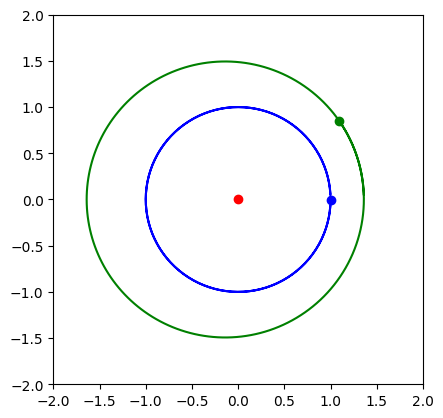

In [1]:
import pyorb
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Initialize the Earth's orbit with appropriate elements
earth_orbit = pyorb.Orbit(
    M0=pyorb.M_sol,
    degrees=True,        # Use degrees for angles
    dtype='float64',     # Data type for calculations
)
earth_orbit.update(a=1*pyorb.AU, e=0, i=0, omega=0, Omega=0, anom=0)

# Initialize the other planet's orbit with appropriate elements
planet_orbit = pyorb.Orbit(
    M0=pyorb.M_sol,      # Mass of central object
    degrees=True,        # Use degrees for angles
    dtype='float64',     # Data type for calculations
)
planet_orbit.update(a=1.5*pyorb.AU, e=0.093, i=0, omega=0, Omega=0, anom=0)

# Time parameters
years = 2
frames_per_year = 100
days_per_frame = 365 / frames_per_year
num_frames = years * 100
dts = np.ones(num_frames) * 24 * 60 * 60 * days_per_frame

# Generate positions for both orbits
earth_positions = []
planet_positions = []
for t in dts:
    earth_orbit.propagate(t)
    earth_positions.append(earth_orbit.r[:,0]/pyorb.AU)

    planet_orbit.propagate(t)
    planet_positions.append(planet_orbit.r[:,0]/pyorb.AU)

earth_positions = np.array(earth_positions)
planet_positions = np.array(planet_positions)

# Plot setup
fig, ax = plt.subplots()
ax.set_xlim(-2, 2)
ax.set_ylim(-2, 2)
ax.set_aspect('equal')
earth_line, = ax.plot([], [], 'b-', label='Earth')
planet_line, = ax.plot([], [], 'g-', label='Planet')
earth_point, = ax.plot([], [], 'bo')
planet_point, = ax.plot([], [], 'go')
sun_point, = ax.plot([0], [0], 'ro')  # Sun at the origin

# Initialize function
def init():
    earth_line.set_data([], [])
    planet_line.set_data([], [])
    earth_point.set_data([], [])
    planet_point.set_data([], [])
    return earth_line, planet_line, earth_point, planet_point

# Animation function
def animate(i):
    earth_line.set_data(earth_positions[:i, 0], earth_positions[:i, 1])
    planet_line.set_data(planet_positions[:i, 0], planet_positions[:i, 1])
    earth_point.set_data(earth_positions[i, 0], earth_positions[i, 1])
    planet_point.set_data(planet_positions[i, 0], planet_positions[i, 1])
    return earth_line, planet_line, earth_point, planet_point

# Create animation
ani = FuncAnimation(fig, animate, init_func=init, frames=num_frames, interval=50, blit=True)

# Display animation in Colab
HTML(ani.to_jshtml())

In [ ]:
print(earth_positions)

[[ 1.          0.          0.        ]
 [ 0.99413236  0.10817048  0.        ]
 [ 0.94760357  0.3194487   0.        ]
 ...
 [-0.59623705  0.80280844  0.        ]
 [-0.75721188 -0.65316933 -0.        ]
 [ 0.7790203  -0.62699871  0.        ]]


/var/folders/ry/qny1f95136l2lpppg_d78n6c0000gq/T/ipykernel_41982/3564713853.py:71: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  earth_point.set_data(earth_positions[i, 0], earth_positions[i, 1])
/var/folders/ry/qny1f95136l2lpppg_d78n6c0000gq/T/ipykernel_41982/3564713853.py:72: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  planet_point.set_data(planet_positions[i, 0], planet_positions[i, 1])
/var/folders/ry/qny1f95136l2lpppg_d78n6c0000gq/T/ipykernel_41982/3564713853.py:71: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  earth_point.set_data(earth_positions[i, 0], earth_positions[i, 1])
/var/folders/ry/qny1f95136l2lpppg_d78n6c0000gq/T/ipykernel_41982/3564713853.py:72: MatplotlibDeprecationWarning: Setting data with a 

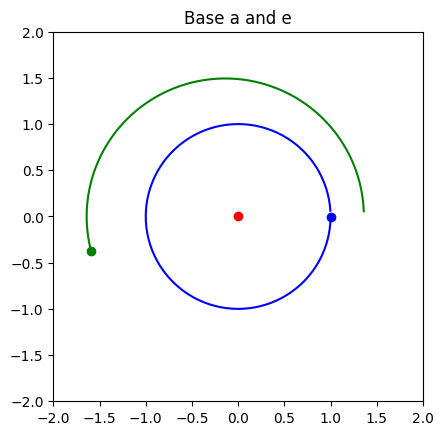

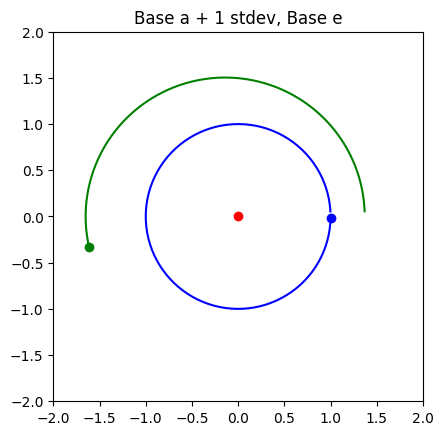

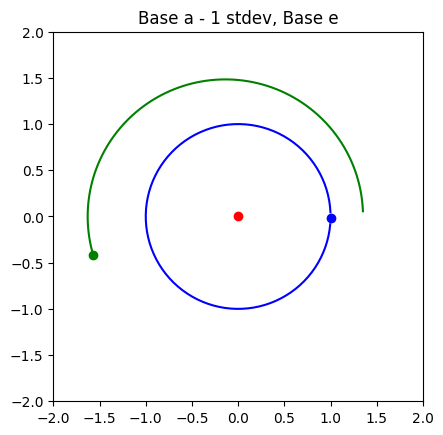

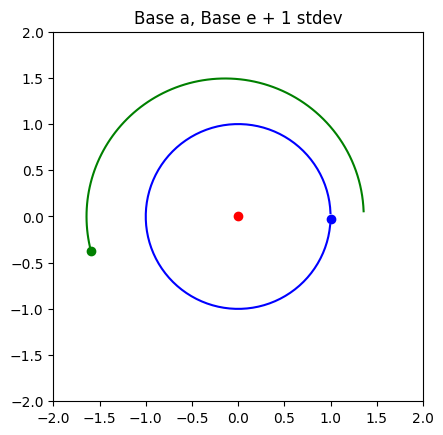

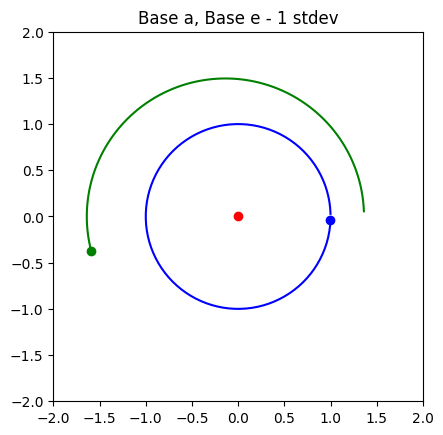

In [2]:
import pyorb
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def create_orbit_animations(earth_init_pos=0, obj_init_pos=0, a=1.5, e=0.093, a_err=0.01, e_err=0.001):
    # Initialize the Earth's orbit with appropriate elements
    earth_orbit = pyorb.Orbit(
        M0=pyorb.M_sol,
        degrees=True,        # Use degrees for angles
        dtype='float64',     # Data type for calculations
    )
    earth_orbit.update(a=1*pyorb.AU, e=0, i=0, omega=0, Omega=0, anom=earth_init_pos)

    # Function to create the planet's orbit and generate positions
    def generate_orbit_positions(a, e, obj_init_pos):
        planet_orbit = pyorb.Orbit(
            M0=pyorb.M_sol,      # Mass of central object
            degrees=True,        # Use degrees for angles
            dtype='float64',     # Data type for calculations
        )
        planet_orbit.update(a=a*pyorb.AU, e=e, i=0, omega=0, Omega=0, anom=obj_init_pos)

        # Time parameters
        years = 2
        frames_per_year = 100
        days_per_frame = 365 / frames_per_year
        num_frames = years * 100
        dts = np.ones(num_frames) * 24 * 60 * 60 * days_per_frame

        # Generate positions for both orbits
        earth_positions = []
        planet_positions = []
        for t in dts:
            earth_orbit.propagate(t)
            earth_positions.append(earth_orbit.r[:,0]/pyorb.AU)

            planet_orbit.propagate(t)
            planet_positions.append(planet_orbit.r[:,0]/pyorb.AU)

        earth_positions = np.array(earth_positions)
        planet_positions = np.array(planet_positions)
        return earth_positions, planet_positions

    # Plot and create animation for each case
    def create_animation(earth_positions, planet_positions, title):
        fig, ax = plt.subplots()
        ax.set_xlim(-2, 2)
        ax.set_ylim(-2, 2)
        ax.set_aspect('equal')
        ax.set_title(title)
        earth_line, = ax.plot([], [], 'b-', label='Earth')
        planet_line, = ax.plot([], [], 'g-', label='Planet')
        earth_point, = ax.plot([], [], 'bo')
        planet_point, = ax.plot([], [], 'go')
        sun_point, = ax.plot([0], [0], 'ro')  # Sun at the origin

        # Initialize function
        def init():
            earth_line.set_data([], [])
            planet_line.set_data([], [])
            earth_point.set_data([], [])
            planet_point.set_data([], [])
            return earth_line, planet_line, earth_point, planet_point

        # Animation function
        def animate(i):
            earth_line.set_data(earth_positions[:i, 0], earth_positions[:i, 1])
            planet_line.set_data(planet_positions[:i, 0], planet_positions[:i, 1])
            earth_point.set_data(earth_positions[i, 0], earth_positions[i, 1])
            planet_point.set_data(planet_positions[i, 0], planet_positions[i, 1])
            return earth_line, planet_line, earth_point, planet_point

        # Create animation
        ani = FuncAnimation(fig, animate, init_func=init, frames=100, interval=50, blit=True)

        # Display animation in Colab
        return HTML(ani.to_jshtml())

    # Generate and display animations for each case
    cases = [
        (a, e, "Base a and e"),
        (a + a_err, e, "Base a + 1 stdev, Base e"),
        (a - a_err, e, "Base a - 1 stdev, Base e"),
        (a, e + e_err, "Base a, Base e + 1 stdev"),
        (a, e - e_err, "Base a, Base e - 1 stdev")
    ]

    animations = []
    for a_val, e_val, title in cases:
        earth_positions, planet_positions = generate_orbit_positions(a_val, e_val, obj_init_pos)
        animations.append(create_animation(earth_positions, planet_positions, title))
    
    return animations

# Example usage:
animations = create_orbit_animations()
for anim in animations:
    display(anim)

/var/folders/ry/qny1f95136l2lpppg_d78n6c0000gq/T/ipykernel_41982/1872240247.py:75: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  earth_point.set_data(earth_positions[i, 0], earth_positions[i, 1])
/var/folders/ry/qny1f95136l2lpppg_d78n6c0000gq/T/ipykernel_41982/1872240247.py:78: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  point.set_data(positions[i, 0], positions[i, 1])


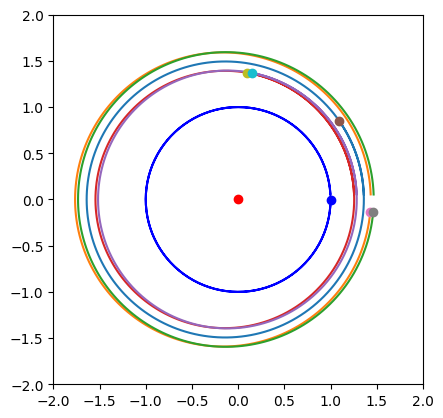

In [4]:
import pyorb
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Function to create the animation
def create_orbit_animation(earth_initial_position=0, obj_initial_position=0, a=1.5, e=0.093, a_err=0.1, e_err=0.01):
    # Initialize the Earth's orbit with appropriate elements
    earth_orbit = pyorb.Orbit(
        M0=pyorb.M_sol,
        degrees=True,        # Use degrees for angles
        dtype='float64',     # Data type for calculations
    )
    earth_orbit.update(a=1*pyorb.AU, e=0, i=0, omega=0, Omega=0, anom=earth_initial_position)
    
    # Initialize orbits for the objects with base and varied a and e
    orbits = []
    variations = [(a, e), (a + a_err, e + e_err), (a + a_err, e - e_err), (a - a_err, e + e_err), (a - a_err, e - e_err)]
    
    for a_var, e_var in variations:
        orbit = pyorb.Orbit(
            M0=pyorb.M_sol,
            degrees=True,        # Use degrees for angles
            dtype='float64',     # Data type for calculations
        )
        orbit.update(a=a_var*pyorb.AU, e=e_var, i=0, omega=0, Omega=0, anom=obj_initial_position)
        orbits.append(orbit)
    
    # Time parameters
    years = 2
    frames_per_year = 100
    days_per_frame = 365 / frames_per_year
    num_frames = years * frames_per_year
    dts = np.ones(num_frames) * 24 * 60 * 60 * days_per_frame
    
    # Generate positions for all orbits
    earth_positions = []
    object_positions = [[] for _ in range(len(orbits))]
    
    for t in dts:
        earth_orbit.propagate(t)
        earth_positions.append(earth_orbit.r[:,0]/pyorb.AU)
        
        for idx, orbit in enumerate(orbits):
            orbit.propagate(t)
            object_positions[idx].append(orbit.r[:,0]/pyorb.AU)
    
    earth_positions = np.array(earth_positions)
    object_positions = [np.array(positions) for positions in object_positions]
    
    # Plot setup
    fig, ax = plt.subplots()
    ax.set_xlim(-2, 2)
    ax.set_ylim(-2, 2)
    ax.set_aspect('equal')
    earth_line, = ax.plot([], [], 'b-', label='Earth')
    object_lines = [ax.plot([], [], '-', label=f'Object {i+1}')[0] for i in range(len(orbits))]
    earth_point, = ax.plot([], [], 'bo')
    object_points = [ax.plot([], [], 'o')[0] for _ in range(len(orbits))]
    sun_point, = ax.plot([0], [0], 'ro')  # Sun at the origin
    
    # Initialize function
    def init():
        earth_line.set_data([], [])
        earth_point.set_data([], [])
        for line, point in zip(object_lines, object_points):
            line.set_data([], [])
            point.set_data([], [])
        return [earth_line, earth_point] + object_lines + object_points
    
    # Animation function
    def animate(i):
        earth_line.set_data(earth_positions[:i, 0], earth_positions[:i, 1])
        earth_point.set_data(earth_positions[i, 0], earth_positions[i, 1])
        for line, point, positions in zip(object_lines, object_points, object_positions):
            line.set_data(positions[:i, 0], positions[:i, 1])
            point.set_data(positions[i, 0], positions[i, 1])
        return [earth_line, earth_point] + object_lines + object_points
    
    # Create animation
    ani = FuncAnimation(fig, animate, init_func=init, frames=num_frames, interval=50, blit=True)
    
    # Display animation in Colab
    return HTML(ani.to_jshtml())

# Example usage
create_orbit_animation(a=1.5, e=0.093, a_err=0.01, e_err=0.1)

